<a href="https://colab.research.google.com/github/arvindcsekar/GW-PTA-PINN/blob/main/PINN_GW_multiparam.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

/tmp/ipython-input-4085918982.py:40: DeprecationWarning:

__array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)



Epoch 0 | Total: 24822506724828604.00000 | BC: 0.24823 | Residual: 0.00000
Epoch 100 | Total: 349943048.73263 | BC: 0.00000 | Residual: 0.00000
Epoch 200 | Total: 64.88691 | BC: 0.00000 | Residual: 0.00000
Epoch 300 | Total: 15.20664 | BC: 0.00000 | Residual: 0.00000
Epoch 400 | Total: 0.07354 | BC: 0.00000 | Residual: 0.00000
Epoch 500 | Total: 3.08616 | BC: 0.00000 | Residual: 0.00000
Epoch 600 | Total: 0.81278 | BC: 0.00000 | Residual: 0.00000
Epoch 700 | Total: 2.75612 | BC: 0.00000 | Residual: 0.00000
Epoch 800 | Total: 4.22727 | BC: 0.00000 | Residual: 0.00000
Epoch 900 | Total: 2.98508 | BC: 0.00000 | Residual: 0.00000


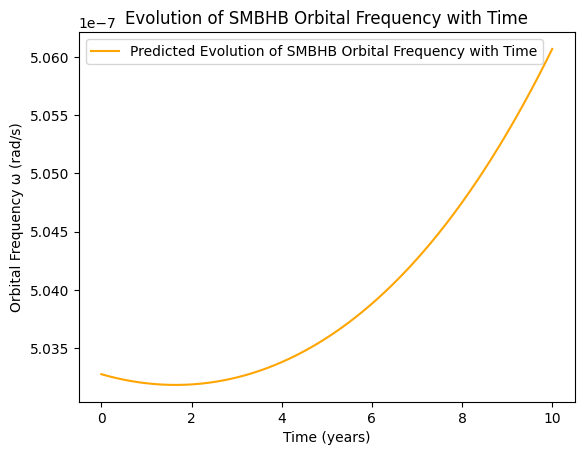

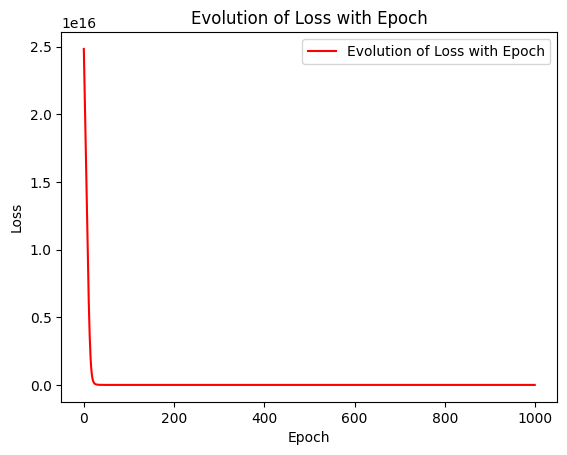

In [20]:
import numpy as np
import matplotlib.pyplot as plt
import astropy.constants as ac
import astropy.units as u
import plotly.graph_objects as go
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.ticker as ticker

G = ac.G.value #big G constant
c = ac.c.value #light
M_sun = ac.M_sun.value
m_one = 1e9 * M_sun
m_total = 2.0 * m_one
nu = 1 #stated
eta = 0.25 #assuming both SMBHs of identical mass (1e9 solar masses)
omg_a = (5e-7 / u.s).to(1/u.s).value #from Kepler relation
m_chirp = (eta**(3/5)) * m_total  # kg
m_c = m_chirp
omg_positive = (5e-7 / u.s).to(1/u.s).value
yr = u.yr.to(u.s)
GMsun = ac.GM_sun.value
dsun = GMsun/(c**2)
tsun = GMsun/(c**3)
pc = ac.pc.value

torch.manual_seed(42)
np.random.seed(42)
G = torch.tensor(ac.G.value, dtype=torch.float64) #big G constant
c = torch.tensor(ac.c.value, dtype=torch.float64) #light
m = 1e9
m_c = m_chirp = torch.tensor((m**2)**(3/5) / ((2 * m )**(1/5)), dtype=torch.float64)  # chirp mass
m_total = torch.tensor(2*m, dtype=torch.float64) #total mass
nu = torch.tensor(1.0, dtype=torch.float64) #stated
eta = torch.tensor(0.25, dtype=torch.float64) #assuming both SMBHs of identical mass (1e9 solar masses)
m=m_c/eta**(3/5)
tN_ = m_c*omg_a*tsun
tm_ = m*omg_a*tsun
delta=np.sqrt(1-4*eta)
omg_a = (5e-7 / u.s).to(1/u.s).value #from Kepler relation

class PINN(nn.Module):
  def __init__(self):
    super(PINN, self).__init__()
    self.net = nn.Sequential(
      nn.Linear(3, 64), #input 3 neuron (time, chi_1, chi_2), then 64 neurons in each hidden layer
      nn.Tanh(), #activation function
      nn.Linear(64, 64),
      nn.Tanh(),
      nn.Linear(64, 64),
      nn.Tanh(),
      nn.Linear(64, 64),
      nn.Tanh(),
      nn.Linear(64, 1, bias=True) #output layer, 1 neuron (solution, omega)
    )
    self.double() #Ensure the model parameters are of type float64

  def forward(self, x):
    return torch.sigmoid(self.net(x))


num_points = 30000
t_end = (10 * u.yr).to(u.s).value  #10 years in seconds
t_0 = 0
t = torch.rand(num_points, 1, dtype=torch.float64) #b/w t=0 and coalescence time, NORMALISED
chi_1 = torch.rand(num_points, 1, dtype=torch.float64)*2 - 1
chi_2 = torch.rand(num_points, 1, dtype=torch.float64)*2 - 1
inputs = torch.cat([t, chi_1, chi_2], dim=1).requires_grad_()

omg_enforced = torch.tensor((5e-7 / u.s).to(1/u.s).value, dtype=torch.float64) #kepler's relation for typical omg value at t=0, with M = 1e9 and R = 0.1pc

t_bc2 = torch.tensor([0.0], dtype=torch.float64).view(-1, 1)
loss_MSE = nn.MSELoss() #mean squared

#weights
w1 = 1e17
w2 = 7

def compute_residual_loss(model, num_points):
    t_residual = torch.rand(num_points, 1, dtype=torch.float64) * t_end
    chi_1_residual = torch.rand(num_points, 1, dtype=torch.float64)*2 - 1
    chi_2_residual = torch.rand(num_points, 1, dtype=torch.float64)*2 - 1
    batch_inputs = torch.cat([t_residual, chi_1_residual, chi_2_residual], dim=1).requires_grad_()
    chi_A_residual = 0.5*(chi_1_residual - chi_2_residual)
    chi_S_residual = 0.5*(chi_1_residual + chi_2_residual)

    Q_15 = (-113/12 * chi_A_residual * delta + 19/3 * chi_S_residual * eta - 113/12 * chi_S_residual + 4*np.pi)


    omg_pred = model(batch_inputs)
    t_phys = t_residual * t_end

    tN_ref = m_c * omg_a * tsun
    tau = 1.0 - (256.0/5.0) * omg_a * (tN_ref**(5.0/3.0)) * t_phys
    tau = torch.clamp(tau, min=1e-12)

    omg_positive = omg_pred
    tN_omg = (G * m_chirp * omg_positive / (c**3))
    tm_omg = (G * m_total * omg_positive / (c**3))  #For Q_15 term

    domg_dt = torch.autograd.grad(omg_positive, batch_inputs, grad_outputs=torch.ones_like(omg_positive),create_graph=True)[0]/t_end
    rhs = (96/5) * (1 + ((59/18*eta**2 + 13661/2016*eta + 34103/18144)/tau**(7/8)) * tm_omg**(4/3) * nu**2 + ((-11/4*eta - 743/336)/tau**(5/8)) * tm_omg**(2/3) * nu + (Q_15 / tau**(3/4)) * tm_omg * nu**(3/2)) * omg_positive**2 * tN_omg**(5/3)

    residual = domg_dt - rhs #LHS - RHS of provided equation
    residual_loss = torch.mean(residual**2) #mean squared
    return residual_loss

model = PINN()
optimiser = optim.Adam(model.parameters(), lr=1e-3) #Adam optimiser w learning rate

epoch_num = 1000
loss_arr = []
for epoch in range(epoch_num):
  optimiser.zero_grad() #clears old grads

  bc_input = torch.cat([t_bc2, torch.zeros_like(t_bc2), torch.zeros_like(t_bc2)], dim=1)
  omg_pred_bc2 = model(bc_input)
  omg_target_bc2 = omg_enforced.view(-1,1)

  bc_loss = loss_MSE(omg_pred_bc2, omg_target_bc2)
  residual_loss = compute_residual_loss(model, num_points)

  omg_pred = model(inputs)

  total_loss = w1 * bc_loss + w2 * residual_loss
  total_loss.backward() #back propagation, calculates how much weights should change
  torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
  loss_arr.append(total_loss.item())
  optimiser.step() #updates weights using gradients computed in back propagation

  if epoch % 100 == 0:
        print(f"Epoch {epoch} | Total: {total_loss.item():.5f} | BC: {bc_loss.item():.5f} | Residual: {residual_loss.item():.5f}")

t_values = np.linspace(0, 1, 1000) #normalised
chi_A_values = np.linspace(-0.5, 0.5, 1000)
chi_S_values = np.linspace(0, 1, 1000)

t_tensor = torch.tensor(t_values, dtype=torch.float64).view(-1, 1)
t_tensor_upscale = t_tensor * t_end #upscale
new_inputs = torch.cat([t_tensor, torch.tensor(chi_A_values).view(-1, 1), torch.tensor(chi_S_values).view(-1, 1)], dim=1).requires_grad_()
omg_tensor = model(new_inputs)
omega_arr = np.zeros(1000)

t_np = (t_tensor_upscale / u.yr.to(u.s)).detach().numpy() #converting back
omg_np = omg_tensor.detach().numpy()

plt.plot(t_np, omg_np, label="Predicted Evolution of SMBHB Orbital Frequency with Time", color="orange")
plt.title("Evolution of SMBHB Orbital Frequency with Time")
plt.xlabel('Time (years)')
plt.ylabel('Orbital Frequency ω (rad/s)')
plt.legend()
plt.show()

plt.plot(range(epoch_num), loss_arr, label = "Evolution of Loss with Epoch", color="Red")
plt.title("Evolution of Loss with Epoch")
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()


t_plot_n = 60
chi1_plot_n = 60
chi2_plot_n = 60

t_values_plot = np.linspace(0, 1, t_plot_n)
chi_1_values_plot = np.linspace(-1, 1, chi1_plot_n)
chi_2_values_plot = np.linspace(-1, 1, chi2_plot_n)

T, A, S = torch.meshgrid(
    torch.tensor(t_values_plot, dtype=torch.float64),
    torch.tensor(chi_1_values_plot, dtype=torch.float64),
    torch.tensor(chi_2_values_plot, dtype=torch.float64),
    indexing='ij'
)

grid = torch.cat([T.reshape(-1,1), A.reshape(-1,1), S.reshape(-1,1)], dim=1)

with torch.no_grad():
    omg_vals = model(grid).squeeze()

omg_vals = omg_vals.reshape(T.shape)

fig = go.Figure(data=go.Isosurface(
    x=T.flatten(),
    y=A.flatten(),
    z=S.flatten(),
    value=omg_vals.flatten(),
    isomin=omg_vals.min().item(),
    isomax=omg_vals.max().item(),
    surface_count=8,  # number of contour surfaces
    colorscale="Viridis", # cleaner edges
))

fig.update_layout(scene=dict(
    xaxis_title='t (normalized)',
    yaxis_title='chi_1',
    zaxis_title='chi_2'
))
fig.show()

t_plot_n = 60
chiA_plot_n = 60
chiS_plot_n = 60

t_values_plot = np.linspace(0, 1, t_plot_n)
chi_A_values_plot = np.linspace(-0.5, 0.5, chiA_plot_n)
chi_S_values_plot = np.linspace(0, 1, chiS_plot_n)

T, A, S = torch.meshgrid(
    torch.tensor(t_values_plot, dtype=torch.float64),
    torch.tensor(chi_A_values_plot, dtype=torch.float64),
    torch.tensor(chi_S_values_plot, dtype=torch.float64),
    indexing='ij'
)

grid = torch.cat([T.reshape(-1,1), A.reshape(-1,1), S.reshape(-1,1)], dim=1)

with torch.no_grad():
    omg_vals = model(grid).squeeze()

omg_vals = omg_vals.reshape(T.shape)

fig = go.Figure(data=go.Isosurface(
    x=T.flatten(),
    y=A.flatten(),
    z=S.flatten(),
    value=omg_vals.flatten(),
    isomin=omg_vals.min().item(),
    isomax=omg_vals.max().item(),
    surface_count=8,  # number of contour surfaces
    colorscale="Viridis", # cleaner edges
))

fig.update_layout(scene=dict(
    xaxis_title='t (normalized)',
    yaxis_title='chi_A',
    zaxis_title='chi_S'
))
fig.show()


space

[φ] Epoch 0 | Total 2.520e+11 | BC 1.058e+00 | Resid 2.520e+04
[φ] Epoch 100 | Total 6.573e+09 | BC 2.995e+02 | Resid 3.578e+02
[φ] Epoch 200 | Total 1.267e+09 | BC 8.244e+01 | Resid 4.427e+01
[φ] Epoch 300 | Total 8.206e+08 | BC 5.878e+01 | Resid 2.328e+01
[φ] Epoch 400 | Total 4.943e+08 | BC 2.874e+01 | Resid 2.068e+01
[φ] Epoch 500 | Total 3.219e+08 | BC 2.365e+01 | Resid 8.538e+00
[φ] Epoch 600 | Total 2.939e+08 | BC 1.800e+01 | Resid 1.139e+01
[φ] Epoch 700 | Total 2.540e+08 | BC 1.489e+01 | Resid 1.050e+01
[φ] Epoch 800 | Total 2.295e+08 | BC 1.279e+01 | Resid 1.016e+01
[φ] Epoch 900 | Total 1.827e+08 | BC 1.058e+01 | Resid 7.684e+00


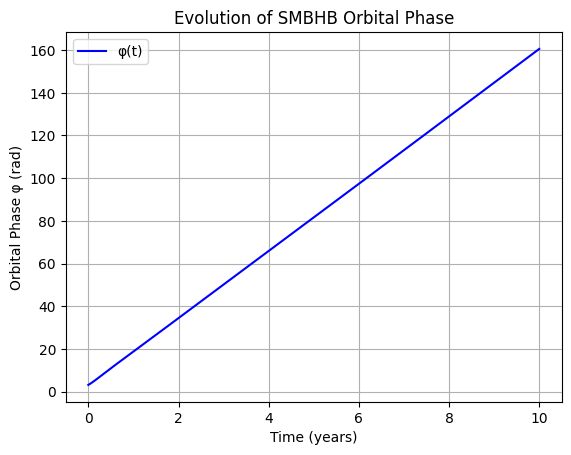

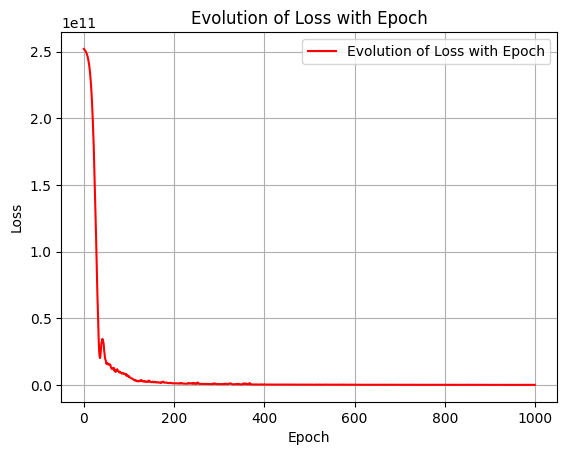

In [21]:
class PINN2(nn.Module):
    def __init__(self):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(1, 64),
            nn.Tanh(),
            nn.Linear(64, 64),
            nn.Tanh(),
            nn.Linear(64, 64),
            nn.Tanh(),
            nn.Linear(64, 1)
        )
        self.double()

    def forward(self, t):
        return torch.exp(self.net(t))

def compute_residual_loss_phi(model2, t_batch, model):
    t_pred = t_batch.requires_grad_()
    phi_pred = model2(t_pred)

    chi_A_zero = torch.zeros_like(t_pred)
    chi_S_zero = torch.zeros_like(t_pred)
    dphi_dtau = torch.autograd.grad(phi_pred, t_pred, grad_outputs=torch.ones_like(phi_pred), create_graph=True)[0]
    omega_here = model(torch.cat([t_pred, chi_A_zero, chi_S_zero], dim=1))

    residual = dphi_dtau - omega_here * t_end
    return torch.mean(residual**2)

phi_enforced = torch.tensor([[0.0]], dtype=torch.float64)
model2 = PINN2()
opt_phi = optim.Adam(model2.parameters(), lr=1e-3)
loss_arr_phi = []
w1 = w2 = 1e7

for epoch in range(epoch_num):
    opt_phi.zero_grad()
    phi_pred_bc = model2(t_bc2)
    bc_loss = loss_MSE(phi_pred_bc, phi_enforced)

    idx = torch.randperm(num_points)[:1024]
    t_batch = t[idx]
    residual_loss = compute_residual_loss_phi(model2, t_batch, model)

    total_loss = w1 *bc_loss + w2 * residual_loss
    total_loss.backward()
    torch.nn.utils.clip_grad_norm_(model2.parameters(), 1.0)
    opt_phi.step()

    loss_arr_phi.append(total_loss.item())
    if epoch % 100 == 0:
        print(f"[φ] Epoch {epoch} | Total {total_loss.item():.3e} | BC {bc_loss.item():.3e} | Resid {residual_loss.item():.3e}")

t_vals = torch.linspace(0, 1, 1000, dtype=torch.float64).view(-1,1)
t_phys = t_vals * t_end

phi_pred = model2(t_vals).detach().numpy()

t_years = (t_phys / u.yr.to(u.s)).detach().numpy()


plt.plot(t_years, phi_pred, label="φ(t)", color="blue")
plt.xlabel("Time (years)")
plt.ylabel("Orbital Phase φ (rad)")
plt.title("Evolution of SMBHB Orbital Phase")
plt.grid()
plt.legend()
plt.show()

plt.plot(range(epoch_num), loss_arr_phi, label = "Evolution of Loss with Epoch", color="Red")
plt.title("Evolution of Loss with Epoch")
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.grid()
plt.show()